In [2]:
import pandas as pd

In [3]:
df = pd.read_csv('./nycflights13.csv.bz2', '\t')

In [4]:
df.columns

Index(['year', 'month', 'day', 'dep_time', 'sched_dep_time', 'dep_delay',
       'arr_time', 'sched_arr_time', 'arr_delay', 'carrier', 'flight',
       'tailnum', 'origin', 'dest', 'air_time', 'distance', 'hour', 'minute',
       'time_hour'],
      dtype='object')

The variables in the dataset are 'year', 'month', 'day', 'dep_time', 'sched_dep_time', 'dep_delay', 'arr_time', 'sched_arr_time', 'arr_delay', 'carrier', 'flight', 'tailnum', 'origin', 'dest', 'air_time', 'distance', 'hour', 'minute', and 'time_hour'

In [5]:
df.shape

(336776, 19)

There were 336776 flights out of NYC in 2013

In [6]:
df.origin.value_counts()

EWR    120835
JFK    111279
LGA    104662
Name: origin, dtype: int64

There are 3 NYC airports in this data: EWR, JFK, LGA

In [7]:
df.dest.nunique()

105

The airlines flew into 105 airports

In [8]:
df[df['dest'] == 'SEA'].shape

(3923, 19)

There were 3923 flights from NYC to Seattle

In [9]:
df[df['dest'] == 'GEG'].shape

(0, 19)

There were no flights from NYC to Spokane

In [10]:
df.dest.str.match('[A-Z]{3}$').value_counts()

True    336776
Name: dest, dtype: int64

There are no missing or invalid destination codes.

I was able to answer all the questions with the provided data. However, only for the first question does it specify that we want info about flights in 2013, which is provided in this data. For the rest, we had to assume that it is referring to 2013 data.

In [11]:
df['arr_delay'].mean()

6.89537675731489

The typical delay for the flights in this dataset is 6.89 minutes

In [12]:
df['arr_delay'].count()

327346

Since the number of non-null values of the delay variable is lower than the total number of records, we know that there are missing values of this variable.

In [13]:
dests = df.copy().groupby('dest')
dests.arr_delay.mean().nlargest(3)

dest
CAE    41.764151
TUL    33.659864
OKC    30.619048
Name: arr_delay, dtype: float64

The worst three destinations in terms of longest typical delay are CAE, TUL, and OKC

In [14]:
df.loc[df['month'].isin([12, 1, 2]), 'season'] = 'Winter'
df.loc[df['month'].isin([3, 4, 5]), 'season'] = 'Spring'
df.loc[df['month'].isin([6, 7, 8]), 'season'] = 'Summer'
df.loc[df['month'].isin([9, 10, 11]), 'season'] = 'Fall'

_The above code was written by referencing https://datatofish.com/if-condition-in-pandas-dataframe/_

In [15]:
import matplotlib.pyplot as plt

In [16]:
df.copy().groupby('season').arr_delay.mean().sort_values(ascending=False)

season
Summer    12.989753
Winter     9.037440
Spring     6.808539
Fall      -1.221250
Name: arr_delay, dtype: float64

It seems like the highest average delays are in Summer and Winter

In [17]:
%matplotlib inline

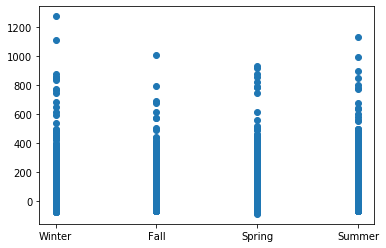

In [18]:
plt.scatter(df['season'], df['arr_delay'])

In [19]:
df[['arr_time', 'arr_delay']].sort_values(by=['arr_delay'], ascending=False)

,arr_time,arr_delay
7072,1242.0,1272.0
235778,1607.0,1127.0
8239,1239.0,1109.0
327043,1457.0,1007.0
270376,1044.0,989.0
...,...,...
336771,NaN,NaN
336772,NaN,NaN
336773,NaN,NaN
336774,NaN,NaN


There doesn't seem to be any particular relation between delay and time.

The biggest problem with these questions is that they do not specify what is considered a delay: arr_delay, dep_delay, or some combination of the two. Because of this, answers will vary depending on which variable was used.

In [27]:
san = df.copy()[df['dest'] == 'SAN']
san.shape

(2737, 20)

There were 2737 flights to San Diego in 2013

In [28]:
san['carrier'].nunique()

4

There are 4 airlines that fly from NYC to San Diego

In [29]:
san['carrier'].value_counts()

UA    1134
B6     663
DL     575
AA     365
Name: carrier, dtype: int64

These airlines are UA, B6, DL, and AA, which flew to San Diego 1134, 663, 575, and 365 times, respectively.

In [30]:
san['tailnum'].nunique()

761

761 unique planes fly from NYC to San Diego

In [31]:
san['origin'].value_counts()

JFK    1603
EWR    1134
Name: origin, dtype: int64

1603 planes arrived from JFK and 1134 arrived from EWR. There were no planes from LGA

In [34]:
def hrs(hmin):
    return (hmin // 100) + (hmin % 100)/60

In [36]:
san['duration'] = hrs(san['arr_time']) - hrs(san['dep_time'])
import numpy as np
san['duration'] = np.where(san.duration > 0, san.duration, san.duration + 24)
san.duration.mean()

2.9443913203383594

The average flight duration was 2.9 hours.

In [37]:
san.duration.max()

6.716666666666665

The slowest flight was 6.72 hours

In [38]:
san.duration.min()

1.8833333333333329

The fastest flight was 1.88 hours

My results seem different than what I would find in flight schedules: it normally takes more than 2 hours to get from NYC to San Diego

In [56]:
len(san[san['arr_delay'] > 15]) / len(san)

0.23310193642674462

23.3% of flights to San Diego were delayed at arrival by more than 15 mins

In [55]:
ewr = san[san['origin'] == 'EWR']
len(ewr[ewr['arr_delay'] > 15]) / len(ewr)

0.2310405643738977

23.1% of flights to San Diego from EWR were delayed at arrival by more than 15 mins.

In [54]:
jfk = san[san['origin'] == 'JFK']
len(jfk[jfk['arr_delay'] > 15]) / len(jfk)

0.23456019962570182

23.5% of flights to San Diego from JFK were delayed at arrival by more than 15 mins

In [43]:
planes = pd.read_csv('./planes.csv.bz2', '\t')

In [44]:
planes.columns

Index(['tailnum', 'year', 'type', 'manufacturer', 'model', 'engines', 'seats',
       'speed', 'engine'],
      dtype='object')

The variables are 'tailnum', 'year', 'type', 'manufacturer', 'model', 'engines', 'seats', 'speed', and 'engine'

In [45]:
planes.shape

(3322, 9)

We have 3322 planes

The merge key would be tailnum

In [46]:
merged = pd.merge(left=df, right=planes)

In [52]:
boeing = merged[merged['model'].str[:2] == "737"]
airbus = merged[merged.model.isin(['A318', 'A319', 'A320', 'A321'])]
len(boeing[boeing['dest'] == 'SAN']) > len(airbus[airbus['dest'] == 'SAN'])

False

There are more Airbus 320 series flying from NYC to San Diego

In [57]:
merged_san = merged[merged['dest'] == 'SAN']
len(merged_san.seats) - merged_san.seats.count()

0

There are no flights to San Diego where we don't have data about the numer of seats in the plane

In [60]:
merged_san[merged_san['seats'] == merged_san.seats.max()]

,year,month,day,dep_time,sched_dep_time,dep_delay,arr_time,sched_arr_time,arr_delay,carrier,...,minute,time_hour,season,type,manufacturer,model,engines,seats,speed,engine
2447,2013,8,19,1629.0,1635,-6.0,1859.0,1938,-39.0,B6,...,35,2013-08-19T20:00:00Z,Summer,Fixed wing multi engine,AIRBUS,A320-232,2,200,NaN,Turbo-fan
3653,2013,9,7,826.0,829,-3.0,1104.0,1122,-18.0,B6,...,29,2013-09-07T12:00:00Z,Fall,Fixed wing multi engine,AIRBUS,A320-232,2,200,NaN,Turbo-fan
3791,2013,11,22,1646.0,1650,-4.0,2026.0,2002,24.0,B6,...,50,2013-11-22T21:00:00Z,Fall,Fixed wing multi engine,AIRBUS,A320-232,2,200,NaN,Turbo-fan
3798,2013,11,27,858.0,900,-2.0,1136.0,1210,-34.0,B6,...,0,2013-11-27T14:00:00Z,Fall,Fixed wing multi engine,AIRBUS,A320-232,2,200,NaN,Turbo-fan
3810,2013,12,25,925.0,900,25.0,1235.0,1210,25.0,B6,...,0,2013-12-25T14:00:00Z,Winter,Fixed wing multi engine,AIRBUS,A320-232,2,200,NaN,Turbo-fan


The largest plane that flew to San Diego was an Airbus A320-232 which had 200 seats

In [62]:
merged_san.groupby('origin').median()

,year,month,day,dep_time,sched_dep_time,dep_delay,arr_time,sched_arr_time,arr_delay,flight,air_time,distance,hour,minute,engines,seats,speed
origin,,,,,,,,,,,,,,,,,
EWR,2013,9,17,1731.0,1729,4.0,2021.0,2030,-5.0,1200,322.0,2425,17,35,2,191,NaN
JFK,2013,11,22,925.0,900,-3.0,1235.0,1210,-18.0,189,322.0,2446,9,29,2,200,NaN


The median numbers of seats to San Diego from EWR is 191 and from JFK is 200.

The main issue I see with the data is the lack of 